In [64]:
import pandas as pd
import geopandas as gpd
import libpysal as lp
import matplotlib.pyplot as plt
import rasterio as rio
import numpy as np
import contextily as ctx
import shapely.geometry as geom
%matplotlib inline
import requests
from bs4 import BeautifulSoup
import json
import mapclassify as mc
import datetime as dt
from dateutil.parser import parse

In [65]:
df = pd.read_csv("2018_Pre-K_School_Directory.csv")

In [66]:
df.columns

Index(['schooldbn', 'locationname', 'final_address', 'borough', 'district',
       'prek_type', 'phone', 'contact_name', 'contact_email', 'website',
       'meals', 'play', 'income_flg', 'uniforms', 'singlegender',
       'programname1', 'programname2', 'programname3', 'programcode1',
       'programcode2', 'programcode3', 'nyceec_current_all',
       'nyceec_current_some', 'nyceec_current_none', 'nyceec_siblings_all',
       'nyceec_siblings_some', 'nyceec_siblings_none', 'nyceec_services_all',
       'nyceec_services_some', 'nyceec_services_none', 'nyceec_targetlang_all',
       'nyceec_targetlang_some', 'nyceec_targetlang_none', 'nyceec_others_all',
       'nyceec_others_some', 'nyceec_others_none', 'district_zonedsib_all',
       'district_zonedsib_some', 'district_zonedsib_none',
       'district_otherzone_all', 'district_otherzone_some',
       'district_otherzone_none', 'district_districtsibs_all',
       'district_districtsibs_some', 'district_districtsibs_none',
       'distri

In [67]:
df

,schooldbn,locationname,final_address,borough,district,prek_type,phone,contact_name,contact_email,website,...,hours,Postcode,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
0,01M015,P.S. 15 Roberto Clemente,"333 East 4th Street, Manhattan NY 10009",Manhattan,1,District School,212-228-8730,Laura Salmon,LSalmon@schools.nyc.gov,www.PS15.org,...,8:40am-3pm,10009.0,40.721807,-73.979022,3.0,2.0,2601.0,1004415.0,1.003740e+09,Lower East Side ...
1,01M019,P.S. 19 Asher Levy,"185 First Avenue, Manhattan NY 10003",Manhattan,1,District School,212-533-5340,Jacqueline Flanagan,jflanagan@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m019,...,8am-2:20pm,10003.0,40.729636,-73.983818,3.0,2.0,40.0,1006478.0,1.004530e+09,East Village ...
2,01M020,P.S. 20 Anna Silver,"166 Essex Street, Manhattan NY 10002",Manhattan,1,District School,212-254-9577,Sarah Pinto Viagran,spinto4@schools.nyc.gov,ps20m.org,...,8:20am-2:40pm,10002.0,40.721540,-73.986648,3.0,1.0,3001.0,1004325.0,1.003550e+09,Chinatown ...
3,01M034,P.S. 34 Franklin D. Roosevelt,"730 East 12th Street, Manhattan NY 10009",Manhattan,1,District School,212-228-4433,Rosemarie Gonzalez,aloukatos@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m034,...,Contact program,10009.0,40.726473,-73.975181,3.0,2.0,28.0,1004564.0,1.003810e+09,Lower East Side ...
4,01M063,The STAR Academy - P.S. 63,"121 East 3rd Street, Manhattan NY 10009",Manhattan,1,District School,212-674-3180,Darlene Cameron,dcameron2@schools.nyc.gov,staracademyps63.com,...,8:15am-2:35pm,10009.0,40.724117,-73.986381,3.0,2.0,32.0,1005760.0,1.004310e+09,East Village ...
5,01M064,P.S. 64 Robert Simon,"600 East 6th Street, Manhattan NY 10009",Manhattan,1,District School,212-673-6510,Marlon L. Hosang,mhosang@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m064,...,8:20am-2:40pm,10009.0,40.724380,-73.981380,3.0,2.0,2601.0,1004627.0,1.003870e+09,Lower East Side ...
6,01M110,P.S. 110 Florence Nightingale,"285 Delancy Street, Manhattan NY 10002",Manhattan,1,District School,212-674-2690,Karen Feuer,KFeuer@schools.nyc.gov,ps110pta.org,...,Contact program,10002.0,40.715915,-73.979893,3.0,1.0,12.0,1004066.0,1.003310e+09,Lower East Side ...
7,01M134,P.S. 134 Henrietta Szold,"293 East Broadway, Manhattan NY 10002",Manhattan,1,District School,212-673-4470,Daniel Kim,dkim@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m134,...,8:15am-2:35pm,10002.0,40.714570,-73.983724,3.0,1.0,202.0,1003736.0,1.002880e+09,Lower East Side ...
8,01M140,P.S. 140 Nathan Straus,"123 Ridge Street, Manhattan NY 10002",Manhattan,1,District School,212-677-4680,Melissa Rodriguez,mrodrig19@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m140,...,8am-2:20pm,10002.0,40.719250,-73.983056,3.0,1.0,2201.0,1004091.0,1.003440e+09,Lower East Side ...
9,06M005,P.S. 5 Ellen Lurie,"3703 Tenth Avenue, Manhattan NY 10034",Manhattan,6,District School,212-567-8109,Latosha Thomas,lthomas25@schools.nyc.gov,schools.nyc.gov/schoolportals/06/m005,...,8am-2:20pm,10034.0,40.858990,-73.922894,12.0,10.0,299.0,1084201.0,1.021500e+09,Marble Hill-Inwood ...


In [68]:
df.loc[df['latepickup'] == "Contact program for time", 'latepickup'] = np.nan
df.loc[df['latepickup'] == "Contact program", 'latepickup'] = np.nan

In [69]:
df.loc[df['earlydropoff'] == "Contact program for time", 'earlydropoff'] = np.nan
df.loc[df['earlydropoff'] == "Contact program", 'earlydropoff'] = np.nan

In [70]:
#pd.to_datetime(df['earlydropoff'], errors = "ignore")
pd.to_datetime(df['earlydropoff'], format = '%H:%M%p', errors = "coerce")
#pd.to_datetime(df['earlydropoff'], errors = "coerce").dt.time

0                      NaT
1                      NaT
2                      NaT
3                      NaT
4      1900-01-01 07:45:00
5                      NaT
6                      NaT
7                      NaT
8                      NaT
9                      NaT
10     1900-01-01 07:45:00
11     1900-01-01 07:30:00
12                     NaT
13                     NaT
14                     NaT
15     1900-01-01 07:45:00
16     1900-01-01 07:45:00
17                     NaT
18     1900-01-01 07:50:00
19                     NaT
20                     NaT
21                     NaT
22                     NaT
23                     NaT
24                     NaT
25                     NaT
26                     NaT
27                     NaT
28                     NaT
29                     NaT
               ...        
1759   1900-01-01 07:30:00
1760                   NaT
1761                   NaT
1762   1900-01-01 07:30:00
1763                   NaT
1764                   NaT
1

In [98]:
#df.earlydropoff

datetime.datetime(2019, 11, 12, 8, 0)

In [71]:
df['earlydropoff_dt'] = ''
df['latepickup_dt'] = ''
#parse(df['earlydropoff']).strftime("%H:%M%p")

for index, row in df.iterrows():
    try:
        dropoff_dt = parse(row['earlydropoff']).strftime("%I:%M%p")
        pickup_dt = parse(row['latepickup']).strftime("%I:%M%p")
        df.at[index, 'earlydropoff_dt'] = dropoff_dt
        df.at[index, 'latepickup_dt'] = pickup_dt
    except:
        print("error", index)

error 0
error 1
error 2
error 3
error 5
error 6
error 7
error 8
error 9
error 12
error 13
error 14
error 17
error 19
error 20
error 22
error 23
error 24
error 26
error 28
error 29
error 31
error 33
error 34
error 35
error 36
error 37
error 38
error 39
error 40
error 41
error 42
error 43
error 44
error 45
error 46
error 47
error 48
error 49
error 50
error 51
error 52
error 53
error 54
error 55
error 56
error 57
error 58
error 59
error 60
error 61
error 62
error 63
error 64
error 65
error 66
error 68
error 69
error 73
error 74
error 75
error 77
error 80
error 81
error 82
error 83
error 84
error 85
error 86
error 89
error 90
error 91
error 92
error 93
error 95
error 98
error 99
error 100
error 101
error 102
error 103
error 104
error 105
error 107
error 108
error 109
error 110
error 111
error 112
error 113
error 114
error 115
error 117
error 118
error 119
error 120
error 121
error 122
error 123
error 124
error 125
error 126
error 127
error 128
error 129
error 130
error 132
error 133
error 

error 1295
error 1296
error 1297
error 1298
error 1299
error 1300
error 1301
error 1302
error 1303
error 1304
error 1305
error 1306
error 1307
error 1308
error 1309
error 1314
error 1320
error 1327
error 1336
error 1341
error 1342
error 1343
error 1344
error 1345
error 1346
error 1347
error 1348
error 1349
error 1350
error 1351
error 1352
error 1353
error 1354
error 1355
error 1356
error 1357
error 1358
error 1359
error 1360
error 1361
error 1362
error 1363
error 1365
error 1366
error 1367
error 1368
error 1369
error 1370
error 1371
error 1372
error 1373
error 1374
error 1375
error 1382
error 1383
error 1384
error 1386
error 1388
error 1389
error 1390
error 1391
error 1392
error 1393
error 1394
error 1396
error 1397
error 1398
error 1400
error 1401
error 1402
error 1403
error 1404
error 1405
error 1406
error 1407
error 1408
error 1409
error 1411
error 1412
error 1413
error 1414
error 1415
error 1418
error 1419
error 1420
error 1421
error 1422
error 1423
error 1424
error 1425
error 1426

In [127]:
df

,schooldbn,locationname,final_address,borough,district,prek_type,phone,contact_name,contact_email,website,...,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,earlydropoff_dt,latepickup_dt
0,01M015,P.S. 15 Roberto Clemente,"333 East 4th Street, Manhattan NY 10009",Manhattan,1,District School,212-228-8730,Laura Salmon,LSalmon@schools.nyc.gov,www.PS15.org,...,40.721807,-73.979022,3.0,2.0,2601.0,1004415.0,1.003740e+09,Lower East Side ...,,
1,01M019,P.S. 19 Asher Levy,"185 First Avenue, Manhattan NY 10003",Manhattan,1,District School,212-533-5340,Jacqueline Flanagan,jflanagan@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m019,...,40.729636,-73.983818,3.0,2.0,40.0,1006478.0,1.004530e+09,East Village ...,,
2,01M020,P.S. 20 Anna Silver,"166 Essex Street, Manhattan NY 10002",Manhattan,1,District School,212-254-9577,Sarah Pinto Viagran,spinto4@schools.nyc.gov,ps20m.org,...,40.721540,-73.986648,3.0,1.0,3001.0,1004325.0,1.003550e+09,Chinatown ...,,
3,01M034,P.S. 34 Franklin D. Roosevelt,"730 East 12th Street, Manhattan NY 10009",Manhattan,1,District School,212-228-4433,Rosemarie Gonzalez,aloukatos@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m034,...,40.726473,-73.975181,3.0,2.0,28.0,1004564.0,1.003810e+09,Lower East Side ...,,
4,01M063,The STAR Academy - P.S. 63,"121 East 3rd Street, Manhattan NY 10009",Manhattan,1,District School,212-674-3180,Darlene Cameron,dcameron2@schools.nyc.gov,staracademyps63.com,...,40.724117,-73.986381,3.0,2.0,32.0,1005760.0,1.004310e+09,East Village ...,07:45AM,05:30PM
5,01M064,P.S. 64 Robert Simon,"600 East 6th Street, Manhattan NY 10009",Manhattan,1,District School,212-673-6510,Marlon L. Hosang,mhosang@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m064,...,40.724380,-73.981380,3.0,2.0,2601.0,1004627.0,1.003870e+09,Lower East Side ...,,
6,01M110,P.S. 110 Florence Nightingale,"285 Delancy Street, Manhattan NY 10002",Manhattan,1,District School,212-674-2690,Karen Feuer,KFeuer@schools.nyc.gov,ps110pta.org,...,40.715915,-73.979893,3.0,1.0,12.0,1004066.0,1.003310e+09,Lower East Side ...,,
7,01M134,P.S. 134 Henrietta Szold,"293 East Broadway, Manhattan NY 10002",Manhattan,1,District School,212-673-4470,Daniel Kim,dkim@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m134,...,40.714570,-73.983724,3.0,1.0,202.0,1003736.0,1.002880e+09,Lower East Side ...,,
8,01M140,P.S. 140 Nathan Straus,"123 Ridge Street, Manhattan NY 10002",Manhattan,1,District School,212-677-4680,Melissa Rodriguez,mrodrig19@schools.nyc.gov,schools.nyc.gov/schoolportals/01/m140,...,40.719250,-73.983056,3.0,1.0,2201.0,1004091.0,1.003440e+09,Lower East Side ...,,
9,06M005,P.S. 5 Ellen Lurie,"3703 Tenth Avenue, Manhattan NY 10034",Manhattan,6,District School,212-567-8109,Latosha Thomas,lthomas25@schools.nyc.gov,schools.nyc.gov/schoolportals/06/m005,...,40.858990,-73.922894,12.0,10.0,299.0,1084201.0,1.021500e+09,Marble Hill-Inwood ...,,


In [72]:
df['earlydropoff_dt'].value_counts()

           1312
07:30AM     154
08:00AM     120
07:00AM     101
07:45AM      19
07:15AM      19
06:30AM      15
07:50AM       8
08:15AM       6
08:30AM       6
06:45AM       4
07:40AM       4
06:00AM       3
06:55AM       3
07:35AM       3
07:20AM       3
06:40AM       2
07:10AM       2
07:25AM       2
06:15AM       1
07:05AM       1
08:25AM       1
Name: earlydropoff_dt, dtype: int64

In [73]:
df['latepickup_dt'].value_counts()

           1312
06:00PM     277
06:30PM      49
05:45PM      42
05:30PM      34
07:00PM      21
05:00PM      16
04:00PM       8
04:30PM       7
05:55PM       4
06:15PM       4
05:50PM       3
03:30PM       2
06:45PM       2
04:15PM       2
07:30PM       1
06:10PM       1
05:15PM       1
04:50PM       1
04:20PM       1
08:00PM       1
Name: latepickup_dt, dtype: int64

In [74]:
df['hours'].value_counts()

Contact program    971
8am-2:20pm         296
8:30am-2:50pm      152
9am-3:20pm          91
8:20am-2:40pm       85
8:10am-2:30pm       62
8:15am-2:35pm       48
8:40am-3pm          38
8:45am-3:05pm       12
8:05am-2:25pm        9
9:30am-3:50pm        6
8:25am-2:45pm        4
9:10am-3:30pm        3
8:50am-3:10pm        3
7:45am-2:05pm        2
9:20am-3:40pm        2
7:50am-2:10pm        2
8:55am-3:15pm        1
9:15am-3:35pm        1
8:35am-2:55pm        1
Name: hours, dtype: int64

In [75]:
df.loc[df['latepickup_dt']!= '','late_binary'] = 1
df.loc[df['latepickup_dt']== '','late_binary'] = 0

In [76]:
df.loc[df['earlydropoff_dt']!= '','early_binary'] = 1
df.loc[df['earlydropoff_dt']== '','early_binary'] = 0

In [77]:
df_early = df[df['early_binary'] == 1]

In [78]:
df_early.reset_index(inplace = True, drop = True)

In [79]:
df_late = df[df['late_binary'] == 1]
df_late.reset_index(inplace = True, drop = True)
df_late

,schooldbn,locationname,final_address,borough,district,prek_type,phone,contact_name,contact_email,website,...,Community Board,Council District,Census Tract,BIN,BBL,NTA,earlydropoff_dt,latepickup_dt,late_binary,early_binary
0,01M063,The STAR Academy - P.S. 63,"121 East 3rd Street, Manhattan NY 10009",Manhattan,1,District School,212-674-3180,Darlene Cameron,dcameron2@schools.nyc.gov,staracademyps63.com,...,3.0,2.0,32.0,1005760.0,1.004310e+09,East Village ...,07:45AM,05:30PM,1.0,1.0
1,01M142,P.S. 142 Amalia Castro,"100 Attorney Street, Manhattan NY 10002",Manhattan,1,District School,212-598-3800,Jackie Munoz,jmunoz8@schools.nyc.gov,ps142m.org,...,3.0,1.0,1402.0,1004080.0,1.003430e+09,Lower East Side ...,07:45AM,05:30PM,1.0,1.0
2,01M184,P.S. 184 Shuang Wen,"327 Cherry Street, Manhattan NY 10002",Manhattan,1,District School,212-602-9700,Alice Ju Mccabe,MJu2@schools.nyc.gov,ps184m.org,...,3.0,1.0,201.0,1003143.0,1.002450e+09,Lower East Side ...,07:30AM,05:30PM,1.0,1.0
3,01M363,Neighborhood School,"121 East 3rd Street, Manhattan NY 10009",Manhattan,1,District School,212-387-0195,Noemi Mora,NMora@schools.nyc.gov,tnsny.org,...,3.0,2.0,32.0,1005760.0,1.004310e+09,East Village ...,07:45AM,06:00PM,1.0,1.0
4,01M364,Earth School,"600 East 6th Street, Manhattan NY 10009",Manhattan,1,District School,212-477-1735,Abbe Futterman,afutterman2@schools.nyc.gov,theearthschool.org,...,3.0,2.0,2601.0,1004627.0,1.003870e+09,Lower East Side ...,07:45AM,06:00PM,1.0,1.0
5,01MAGR,Saint Brigid School,"185 East 7th Street, Manhattan NY 10009",Manhattan,1,NYCEEC,212-677-5210,Molly Carone,jdelucia@stbrigidschoolny.com,stbrigidschoolny.com,...,3.0,2.0,2602.0,1004703.0,1.003900e+09,Lower East Side ...,07:50AM,05:50PM,1.0,1.0
6,01MAQA,Virginia Day Nursery,"464 East 10th Street, Manhattan NY 10009",Manhattan,1,NYCEEC,212-228-5220,Shayna Williams,shwilliams@shelteringarmsny.org,shelteringarmsny.org,...,3.0,2.0,24.0,1077538.0,1.003620e+09,Lower East Side ...,08:00AM,04:30PM,1.0,1.0
7,01MATQ,Escuela Hispana Montessori 2,"180 Suffolk Street, Manhattan NY 10002",Manhattan,1,NYCEEC,212-982-6650,Lyle Walford,lylewalford12@gmail.com,escuelahispanaelc.com,...,3.0,2.0,3001.0,1004240.0,1.003500e+09,Chinatown ...,08:00AM,06:00PM,1.0,1.0
8,01MAUB,University Settlement ECC,"184 Eldridge Street, Manhattan NY 10002",Manhattan,1,NYCEEC,212-453-4545,Alison Leong,lrivera@universitysettlement.org,universitysettlement.org,...,3.0,1.0,18.0,1005483.0,1.004150e+09,Chinatown ...,08:00AM,06:00PM,1.0,1.0
9,01MAXZ,Henry Street Settlement Day Care,"301 Henry Street, Manhattan NY 10002",Manhattan,1,NYCEEC,212-254-3100,Yulan Wu,ccarrozelli@henrystreet.org,henrystreet.org,...,3.0,1.0,202.0,1003737.0,1.002880e+09,Lower East Side ...,08:00AM,06:00PM,1.0,1.0


In [80]:
df_earlylate = df[(df['late_binary'] == 1) & (df['early_binary'] == 1)]

In [81]:
df_earlylate.reset_index(inplace = True, drop = True)
df_earlylate

,schooldbn,locationname,final_address,borough,district,prek_type,phone,contact_name,contact_email,website,...,Community Board,Council District,Census Tract,BIN,BBL,NTA,earlydropoff_dt,latepickup_dt,late_binary,early_binary
0,01M063,The STAR Academy - P.S. 63,"121 East 3rd Street, Manhattan NY 10009",Manhattan,1,District School,212-674-3180,Darlene Cameron,dcameron2@schools.nyc.gov,staracademyps63.com,...,3.0,2.0,32.0,1005760.0,1.004310e+09,East Village ...,07:45AM,05:30PM,1.0,1.0
1,01M142,P.S. 142 Amalia Castro,"100 Attorney Street, Manhattan NY 10002",Manhattan,1,District School,212-598-3800,Jackie Munoz,jmunoz8@schools.nyc.gov,ps142m.org,...,3.0,1.0,1402.0,1004080.0,1.003430e+09,Lower East Side ...,07:45AM,05:30PM,1.0,1.0
2,01M184,P.S. 184 Shuang Wen,"327 Cherry Street, Manhattan NY 10002",Manhattan,1,District School,212-602-9700,Alice Ju Mccabe,MJu2@schools.nyc.gov,ps184m.org,...,3.0,1.0,201.0,1003143.0,1.002450e+09,Lower East Side ...,07:30AM,05:30PM,1.0,1.0
3,01M363,Neighborhood School,"121 East 3rd Street, Manhattan NY 10009",Manhattan,1,District School,212-387-0195,Noemi Mora,NMora@schools.nyc.gov,tnsny.org,...,3.0,2.0,32.0,1005760.0,1.004310e+09,East Village ...,07:45AM,06:00PM,1.0,1.0
4,01M364,Earth School,"600 East 6th Street, Manhattan NY 10009",Manhattan,1,District School,212-477-1735,Abbe Futterman,afutterman2@schools.nyc.gov,theearthschool.org,...,3.0,2.0,2601.0,1004627.0,1.003870e+09,Lower East Side ...,07:45AM,06:00PM,1.0,1.0
5,01MAGR,Saint Brigid School,"185 East 7th Street, Manhattan NY 10009",Manhattan,1,NYCEEC,212-677-5210,Molly Carone,jdelucia@stbrigidschoolny.com,stbrigidschoolny.com,...,3.0,2.0,2602.0,1004703.0,1.003900e+09,Lower East Side ...,07:50AM,05:50PM,1.0,1.0
6,01MAQA,Virginia Day Nursery,"464 East 10th Street, Manhattan NY 10009",Manhattan,1,NYCEEC,212-228-5220,Shayna Williams,shwilliams@shelteringarmsny.org,shelteringarmsny.org,...,3.0,2.0,24.0,1077538.0,1.003620e+09,Lower East Side ...,08:00AM,04:30PM,1.0,1.0
7,01MATQ,Escuela Hispana Montessori 2,"180 Suffolk Street, Manhattan NY 10002",Manhattan,1,NYCEEC,212-982-6650,Lyle Walford,lylewalford12@gmail.com,escuelahispanaelc.com,...,3.0,2.0,3001.0,1004240.0,1.003500e+09,Chinatown ...,08:00AM,06:00PM,1.0,1.0
8,01MAUB,University Settlement ECC,"184 Eldridge Street, Manhattan NY 10002",Manhattan,1,NYCEEC,212-453-4545,Alison Leong,lrivera@universitysettlement.org,universitysettlement.org,...,3.0,1.0,18.0,1005483.0,1.004150e+09,Chinatown ...,08:00AM,06:00PM,1.0,1.0
9,01MAXZ,Henry Street Settlement Day Care,"301 Henry Street, Manhattan NY 10002",Manhattan,1,NYCEEC,212-254-3100,Yulan Wu,ccarrozelli@henrystreet.org,henrystreet.org,...,3.0,1.0,202.0,1003737.0,1.002880e+09,Lower East Side ...,08:00AM,06:00PM,1.0,1.0


In [82]:
df_geometry = [geom.Point(x, y) for x, y in zip(df.Longitude, df.Latitude)]

In [83]:
gdf = gpd.GeoDataFrame(df, geometry=df_geometry)

In [148]:
gdf.to_file("prek.geojson", driver = "GeoJSON")

In [160]:
df_late_geometry = [geom.Point(x, y) for x, y in zip(df_late.Longitude, df_late.Latitude)]
df_early_geometry = [geom.Point(x, y) for x, y in zip(df_early.Longitude, df_early.Latitude)]

gdf_late = gpd.GeoDataFrame(df_late, geometry=df_late_geometry)
gdf_early = gpd.GeoDataFrame(df_early, geometry=df_early_geometry)

gdf_late.to_file("late.geojson", driver = "GeoJSON")
gdf_early.to_file("early.geojson", driver = "GeoJSON")

In [165]:
df_earlylate_geometry = [geom.Point(x, y) for x, y in zip(df_earlylate.Longitude, df_earlylate.Latitude)]
gdf_earlylate = gpd.GeoDataFrame(df_earlylate, geometry = df_earlylate_geometry)
gdf_earlylate.to_file("earlylate.geojson", driver = "GeoJSON")

In [125]:
acs_df = pd.read_csv("acs17.csv")

In [126]:
acs_df.head()

,Geo_FIPS,Geo_GEOID,Geo_NAME,Geo_QName,Geo_STUSAB,Geo_SUMLEV,Geo_GEOCOMP,Geo_FILEID,Geo_LOGRECNO,Geo_US,...,PCT_SE_A09001_002,PCT_SE_A09001_003,PCT_SE_A09001_004,PCT_SE_A09001_005,PCT_SE_A09001_006,PCT_SE_A09001_007,PCT_SE_A09001_008,PCT_SE_A09001_009,PCT_SE_A09001_010,commute_avg
0,36005000100,14000US36005000100,"Census Tract 1, Bronx County, New York","Census Tract 1, Bronx County, New York",ny,140,0,ACSSF,3481,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
1,36005000200,14000US36005000200,"Census Tract 2, Bronx County, New York","Census Tract 2, Bronx County, New York",ny,140,0,ACSSF,3482,NaN,...,99.51,1.14,19.46,20.27,13.62,18.86,15.48,10.68,0.49,42
2,36005000400,14000US36005000400,"Census Tract 4, Bronx County, New York","Census Tract 4, Bronx County, New York",ny,140,0,ACSSF,3483,NaN,...,98.14,4.07,7.62,13.34,11.24,21.31,28.09,12.46,1.86,48
3,36005001600,14000US36005001600,"Census Tract 16, Bronx County, New York","Census Tract 16, Bronx County, New York",ny,140,0,ACSSF,3484,NaN,...,96.14,4.53,20.26,12.73,15.73,17.73,20.31,4.86,3.86,39
4,36005001900,14000US36005001900,"Census Tract 19, Bronx County, New York","Census Tract 19, Bronx County, New York",ny,140,0,ACSSF,3485,NaN,...,98.08,6.72,10.32,9.28,19.68,23.20,18.08,10.80,1.92,44


In [127]:
acs_df['GEOID'] = acs_df['Geo_FIPS']

In [128]:
tracts = gpd.read_file("nyct2010_19c/nyct2010.shp")
boro_dict = {"1":"061", "2":"005", "3":"047", "4":"081", "5":"085"}
tracts.replace({'BoroCode': boro_dict}, inplace = True)
tracts['GEOID'] = ("36" + tracts.BoroCode + tracts.CT2010).astype(int)

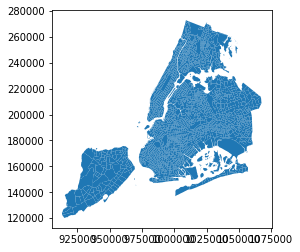

In [100]:
tracts.plot()

In [89]:
type(tracts['GEOID'][0])

numpy.int64

In [129]:
tracts = tracts.merge(acs_df, on = "GEOID")

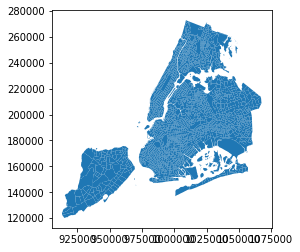

In [91]:
tracts.plot()

In [130]:
tracts = tracts.to_crs(epsg = 3857)

In [93]:
tracts.columns

Index(['CTLabel', 'BoroCode', 'BoroName', 'CT2010', 'BoroCT2010', 'CDEligibil',
       'NTACode', 'NTAName', 'PUMA', 'Shape_Leng',
       ...
       'SE_A09001_010', 'PCT_SE_A09001_002', 'PCT_SE_A09001_003',
       'PCT_SE_A09001_004', 'PCT_SE_A09001_005', 'PCT_SE_A09001_006',
       'PCT_SE_A09001_007', 'PCT_SE_A09001_008', 'PCT_SE_A09001_009',
       'PCT_SE_A09001_010'],
      dtype='object', length=329)

In [131]:
tracts2 = tracts.explode()

In [103]:
tracts2.crs

{'init': 'epsg:2263'}

In [96]:
tracts2 = tracts2.to_crs(epsg = 3857)

In [63]:
tracts2 = tracts2.to_crs(epsg = 900913)

RuntimeError: b'no arguments in initialization list'

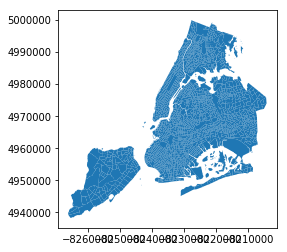

In [45]:
tracts2.plot()

In [104]:
import folium
m = folium.Map([40.76,-74.01], zoom_start=12, tiles="OpenStreetMap")
folium.GeoJson(tracts2.to_json()).add_to(m)
m

In [105]:
m.save('map.html')

In [47]:
m.crs

'EPSG3857'

In [49]:
tracts2.crs

{'init': 'epsg:3857', 'no_defs': True}

In [132]:
tracts2 = tracts2.to_crs(epsg = 4326)

In [133]:
tracts2.to_file("tracts2.geojson", driver = "GeoJSON")

In [ ]:
df.plot(column = "median_price", scheme = "Quantiles", legend = True, ax = ax)

/Users/acarlson/anaconda3/lib/python3.7/site-packages/mapclassify/classifiers.py:320: RuntimeWarning: invalid value encountered in greater
  binIds += (x > l) * (x <= r) * k
/Users/acarlson/anaconda3/lib/python3.7/site-packages/mapclassify/classifiers.py:320: RuntimeWarning: invalid value encountered in less_equal
  binIds += (x > l) * (x <= r) * k
/Users/acarlson/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:3405: RuntimeWarning: Invalid value encountered in median
  r = func(a, **kwargs)


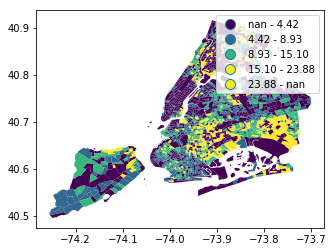

In [135]:
tracts2.plot(column = 'PCT_SE_A10009_005', scheme = "Quantiles", legend = True)

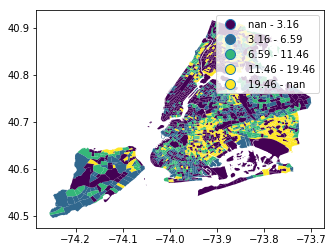

In [136]:
tracts2.plot(column = 'PCT_SE_A10009_007', scheme = "Quantiles", legend = True)

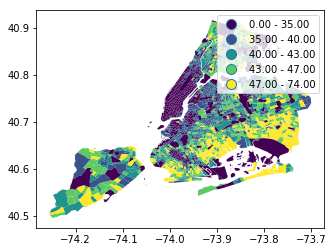

In [138]:
tracts2.plot(column = 'commute_avg', scheme = "Quantiles", legend = True)